In [216]:
%run ./db_connection.ipynb

In [23]:
flight_data_2019 = """
   SELECT 
    mkt_unique_carrier,
    branded_code_share,
    mkt_carrier_fl_num, op_unique_carrier,
    tail_num, op_carrier_fl_num,
    origin_airport_id, dest_airport_id,
    crs_dep_time, dep_time, dep_delay,
    taxi_out, wheels_off, wheels_on,
    taxi_in,
    crs_arr_time,
    arr_time, arr_delay,
    cancelled, cancellation_code,
    diverted,
    dup,
    crs_elapsed_time, actual_elapsed_time,
    air_time,
    flights,
    distance,
    carrier_delay, weather_delay, nas_delay, security_delay, late_aircraft_delay,
    first_dep_time, total_add_gtime, longest_add_gtime,
    fl_date,
    date_part('year', TO_DATE(fl_date,'YYYY-MM-DD')) as year,
    date_part('month', TO_DATE(fl_date,'YYYY-MM-DD')) as month    
   FROM flights
   WHERE date_part('year', TO_DATE(fl_date,'YYYY-MM-DD')) = 2019
"""
    
flight_2019 = execute_read_query(con, flight_data_2019)


In [24]:
flight_2019

,mkt_unique_carrier,branded_code_share,mkt_carrier_fl_num,op_unique_carrier,tail_num,op_carrier_fl_num,origin_airport_id,dest_airport_id,crs_dep_time,dep_time,...,weather_delay,nas_delay,security_delay,late_aircraft_delay,first_dep_time,total_add_gtime,longest_add_gtime,fl_date,year,month
0,AA,AA_CODESHARE,4995,PT,N620AE,4995,14100,12397,2130,NaN,...,NaN,NaN,NaN,NaN,None,NaN,NaN,2019-10-03,2019.0,10.0
1,AA,AA_CODESHARE,5121,OH,N598NN,5121,10868,11057,641,637.0,...,NaN,NaN,NaN,NaN,None,NaN,NaN,2019-10-01,2019.0,10.0
2,AA,AA_CODESHARE,5126,OH,N568NN,5126,14576,11057,1137,1130.0,...,NaN,NaN,NaN,NaN,None,NaN,NaN,2019-10-01,2019.0,10.0
3,AA,AA_CODESHARE,5127,OH,N534AE,5127,11057,11973,930,926.0,...,NaN,NaN,NaN,NaN,None,NaN,NaN,2019-10-01,2019.0,10.0
4,AA,AA_CODESHARE,5127,OH,N534AE,5127,11973,11057,1102,1058.0,...,NaN,NaN,NaN,NaN,None,NaN,NaN,2019-10-01,2019.0,10.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8091679,B6,B6,182,B6,N779JB,182,10693,11697,1653,2053.0,...,0.0,0.0,0.0,219.0,None,NaN,NaN,2019-07-23,2019.0,7.0
8091680,B6,B6,183,B6,N547JB,183,12478,13204,530,558.0,...,0.0,0.0,0.0,0.0,None,NaN,NaN,2019-07-23,2019.0,7.0
8091681,B6,B6,185,B6,N266JB,185,14576,12478,530,517.0,...,NaN,NaN,NaN,NaN,None,NaN,NaN,2019-07-23,2019.0,7.0
8091682,B6,B6,189,B6,N986JB,189,12478,14679,830,824.0,...,NaN,NaN,NaN,NaN,None,NaN,NaN,2019-07-23,2019.0,7.0


### Save the Dataframe

In [70]:
import pickle

filename = 'flight_2019'
outfile = open(filename,'wb')

pickle.dump(flight_2019,outfile)
outfile.close()

### Load the Dataframe from the file

In [ ]:
import pickle

filename = 'flight_2019'

infile = open(filename,'rb')
flight_2019 = pickle.load(infile)
infile.close()

In [26]:
print("Number of rows for 2019", len(flight_2019))

Number of rows for 2019 8091684


### Create a new feature 'total_delay' for each flight

#### New dataframe with a smaller sample of 500,000 records

In [248]:
flight_sample = flight_2019.sample(n=1000000, random_state=1)

In [249]:
flight_sample.shape

(1000000, 38)

#### Replace Nulls in delay columns with 0

In [250]:
flight_sample['dep_delay'] = flight_sample['dep_delay'].fillna(0)
flight_sample['arr_delay'] = flight_sample['arr_delay'].fillna(0)
flight_sample['carrier_delay'] = flight_sample['carrier_delay'].fillna(0)
flight_sample['weather_delay'] = flight_sample['weather_delay'].fillna(0)
flight_sample['nas_delay'] = flight_sample['nas_delay'].fillna(0)
flight_sample['security_delay'] = flight_sample['security_delay'].fillna(0)
flight_sample['late_aircraft_delay'] = flight_sample['late_aircraft_delay'].fillna(0)

#### Create the total_delays column

In [251]:
flight_sample['total_delay'] = flight_sample.apply(
    lambda x: ((x['dep_delay'] + x['arr_delay'] +
                 x['carrier_delay'] +
                 x['weather_delay'] + x['nas_delay'] + x['security_delay'] +
                 x['late_aircraft_delay']
              )),  axis=1)

In [252]:
flight_sample.shape

(1000000, 39)

In [253]:
flight_sample['total_delay']

5817519    357.0
3440584    -16.0
2213756    -49.0
4372882    -15.0
2224046    -16.0
           ...  
3048865      1.0
7686938    -17.0
5571728    -15.0
319962       2.0
672220     -15.0
Name: total_delay, Length: 1000000, dtype: float64

### Create is_delay column

In [254]:
flight_sample['is_delay'] = flight_sample.apply(
    lambda x: (0 if x['total_delay'] <= 0 else 1),  axis=1)

In [255]:
flight_sample.shape

(1000000, 40)

In [256]:
flight_sample['is_delay'].head()

5817519    1
3440584    0
2213756    0
4372882    0
2224046    0
Name: is_delay, dtype: int64

#### Exclude flights that were early (have a negative total delay)

In [257]:
flight_delays_sample = flight_sample[flight_sample['total_delay'] > 0]
flight_delays_sample.head()

,mkt_unique_carrier,branded_code_share,mkt_carrier_fl_num,op_unique_carrier,tail_num,op_carrier_fl_num,origin_airport_id,dest_airport_id,crs_dep_time,dep_time,...,security_delay,late_aircraft_delay,first_dep_time,total_add_gtime,longest_add_gtime,fl_date,year,month,total_delay,is_delay
5817519,DL,DL_CODESHARE,4016,OO,N291SY,4016,12953,13342,1747,1944.0,...,0.0,108.0,None,NaN,NaN,2019-05-23,2019.0,5.0,357.0,1
3190610,WN,WN,3862,WN,N269WN,3862,14831,11292,2135,2154.0,...,0.0,15.0,None,NaN,NaN,2019-11-23,2019.0,11.0,49.0,1
115103,AS,AS,783,AS,N558AS,783,11618,14831,1825,1843.0,...,0.0,0.0,None,NaN,NaN,2019-10-06,2019.0,10.0,11.0,1
4766272,AA,AA,2646,AA,N9624T,2646,11298,10994,1057,1119.0,...,0.0,0.0,None,NaN,NaN,2019-01-04,2019.0,1.0,32.0,1
7690177,AA,AA_CODESHARE,5776,YV,N245LR,5776,11298,12191,847,848.0,...,0.0,1.0,None,NaN,NaN,2019-07-15,2019.0,7.0,45.0,1


In [258]:
# get data that is within +3 to -3 standard deviations in the column 'Data'.
flight_sample_no_outlier = flight_sample[
        abs(flight_sample.total_delay - flight_sample.total_delay.mean()
                         ) <= (3*flight_sample.total_delay.std()
                              )
        ]



In [259]:
flight_sample.shape

(1000000, 40)

### Plot the histogram of delays

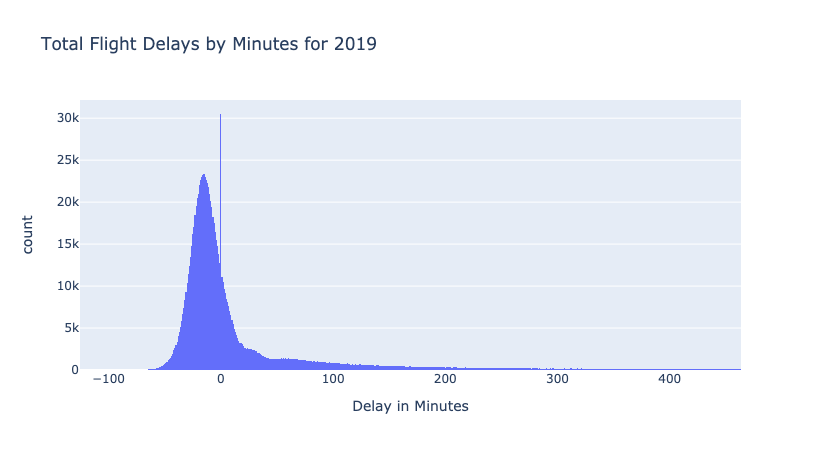

In [260]:
import plotly.express as px

df = px.data.tips()
fig = px.histogram(
        flight_sample_no_outlier, 
        title='Total Flight Delays by Minutes for 2019',
        x="total_delay",
        labels = {'total_delay':'Delay in Minutes'})
fig.show()

In [261]:
print("Median flight delay", flight_sample_no_outlier.total_delay.median(axis=0))

Median flight delay -9.0


### Get Median Delays by Month

In [262]:
flight_delays_by_month = flight_sample[flight_sample['is_delay'] == 1].groupby(
    'month').month.agg(count=('month', 'count')).reset_index()
flight_delays_by_month

,month,count
0,1.0,26063
1,2.0,28189
2,3.0,28263
3,4.0,26771
4,5.0,30735
5,6.0,35799
6,7.0,32160
7,8.0,31718
8,9.0,22162
9,10.0,27434


In [263]:
flight_sample.shape

(1000000, 40)

### Plot the Delays per month

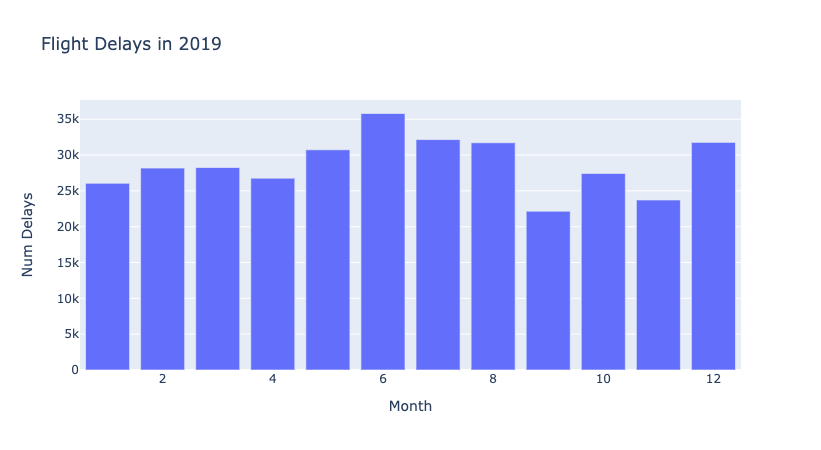

In [264]:
import plotly.express as px
fig = px.bar(flight_delays_by_month, 
             title='Flight Delays in 2019',
             x='month', 
             y='count',
             labels = {'count': 'Num Delays', 'month':'Month'})
fig.show()

More thunderstorms in the summer (May, June, July, Aug)
More cold weather conditions in December

### Get Taxi Times on the Runway by hour of day

#### Create Arrive and Depart Hour of Day columns

In [265]:
from datetime import datetime
flight_sample['arr_hour_of_day'] = flight_sample[flight_sample['arr_time'].notna()].apply(
    lambda x: 0 if x['arr_time'] == 2400.0 else datetime.strptime(str(int(x['arr_time'])).zfill(4), '%H%M').time().hour, axis=1)
flight_sample['arr_hour_of_day'].head()

5817519    21.0
3440584    20.0
2213756    20.0
4372882     8.0
2224046    15.0
Name: arr_hour_of_day, dtype: float64

In [266]:
flight_sample['dep_hour_of_day'] = flight_sample[flight_sample['dep_time'].notna()].apply(
    lambda x: 0 if x['dep_time'] == 2400.0 else datetime.strptime(str(int(x['dep_time'])).zfill(4), '%H%M').time().hour, axis=1)
flight_sample['dep_hour_of_day'].head()

5817519    19.0
3440584    20.0
2213756    18.0
4372882     6.0
2224046    13.0
Name: dep_hour_of_day, dtype: float64

In [267]:
flight_sample.shape

(1000000, 42)

#### Create Taxi In by Hour Dataframe

In [268]:

taxi_in_times_by_hour = flight_sample.groupby(
    'arr_hour_of_day').agg(avg_taxi_in=('taxi_in', 'median')).reset_index()
taxi_in_times_by_hour = taxi_in_times_by_hour.rename(columns={"arr_hour_of_day": "hour_of_day", "avg_taxi_in": "avg_taxi"}, errors="raise")
taxi_in_times_by_hour

,hour_of_day,avg_taxi
0,0.0,6.0
1,1.0,6.0
2,2.0,5.0
3,3.0,6.0
4,4.0,6.0
5,5.0,6.0
6,6.0,7.0
7,7.0,7.0
8,8.0,7.0
9,9.0,6.0


#### Create Taxi Out by Hour Dataframe

In [269]:
taxi_out_times_by_hour = flight_sample.groupby(
    'dep_hour_of_day').agg(avg_taxi_out=('taxi_out', 'median')).reset_index()
taxi_out_times_by_hour = taxi_out_times_by_hour.rename(columns={"dep_hour_of_day": "hour_of_day", "avg_taxi_out": "avg_taxi"}, errors="raise")
taxi_out_times_by_hour


,hour_of_day,avg_taxi
0,0.0,14.0
1,1.0,13.0
2,2.0,12.0
3,3.0,12.0
4,4.0,13.0
5,5.0,14.0
6,6.0,14.0
7,7.0,15.0
8,8.0,17.0
9,9.0,16.0


#### Combine the taxi dataframes and plot the results

In [270]:
taxi_times_by_hour = taxi_in_times_by_hour.append(taxi_out_times_by_hour, ignore_index=True)
taxi_times_by_hour = taxi_times_by_hour.groupby(
    'hour_of_day').agg(avg_taxi=('avg_taxi', 'median')).reset_index()
taxi_times_by_hour

,hour_of_day,avg_taxi
0,0.0,10.0
1,1.0,9.5
2,2.0,8.5
3,3.0,9.0
4,4.0,9.5
5,5.0,10.0
6,6.0,10.5
7,7.0,11.0
8,8.0,12.0
9,9.0,11.0


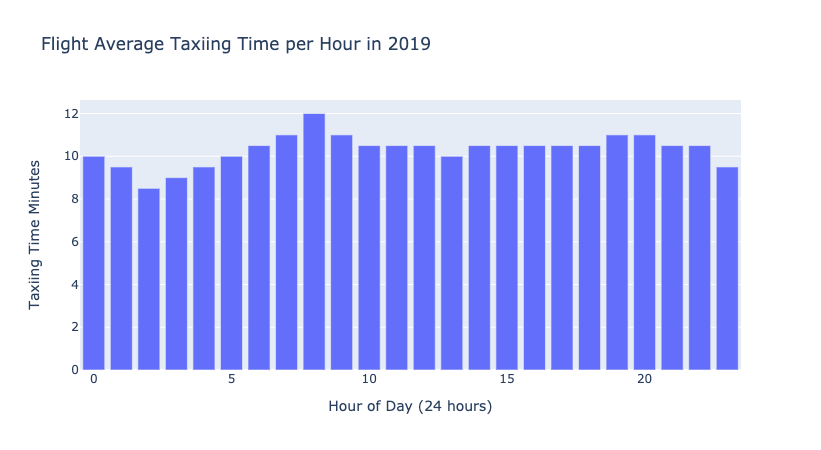

In [271]:
fig = px.bar(taxi_times_by_hour, 
             title='Flight Average Taxiing Time per Hour in 2019',
             x='hour_of_day', 
             y='avg_taxi',
             labels = {'avg_taxi': 'Taxiing Time Minutes', 'hour_of_day':'Hour of Day (24 hours)'})
fig.show()

8am is when the most taxiing occurs

In [272]:
flight_sample.shape

(1000000, 42)

In [170]:
flight_sample['flights'].describe()

count    1000000.0
mean           1.0
std            0.0
min            1.0
25%            1.0
50%            1.0
75%            1.0
max            1.0
Name: flights, dtype: float64

### Get Number of Flights by hour of day

In [273]:
num_flights_by_hour = flight_sample.groupby(
    'arr_hour_of_day').agg(num_flights=('flights', 'count')).reset_index()
num_flights_by_hour.rename(columns = {'arr_hour_of_day':'hour_of_day'}, inplace = True)

#### Plot the histogram of taxi time with bar chart of number of flights

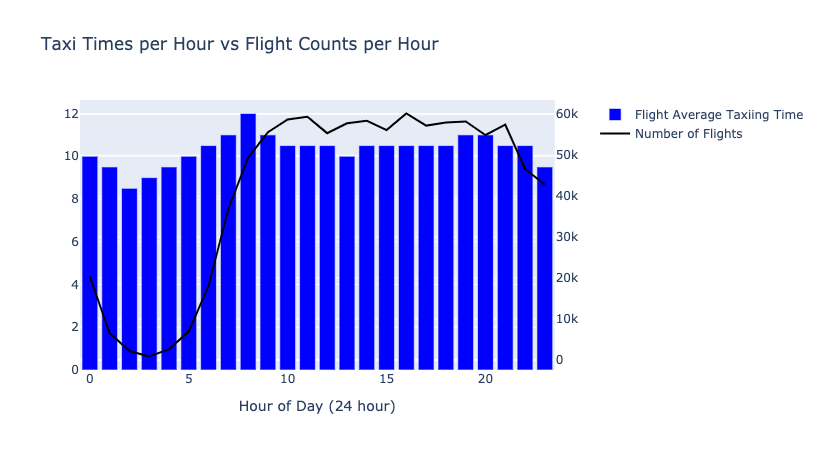

In [274]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

fig = make_subplots(specs=[[{"secondary_y": True}]])

fig.add_trace(
    go.Bar(
        x=taxi_times_by_hour['hour_of_day'],
        y=taxi_times_by_hour['avg_taxi'],
        name='Flight Average Taxiing Time',
        marker_color="blue"
    ),
    secondary_y=False,
)

fig.add_trace(
    go.Scatter(
        x=num_flights_by_hour['hour_of_day'],
        y=num_flights_by_hour['num_flights'],
        name='Number of Flights',
        marker_color="black"
    ),
    secondary_y=True
)


fig.update_layout(
    title="Taxi Times per Hour vs Flight Counts per Hour",
    xaxis_title="Hour of Day (24 hour)")

fig.show()


### Get the busiest Airports

#### Get the city and state of each airport

In [217]:
   
flight_locations_2019 = """
   SELECT 
    origin_city_name, dest_city_name,
    origin_airport_id, dest_airport_id
   FROM flights
   WHERE date_part('year', TO_DATE(fl_date,'YYYY-MM-DD')) = 2019
"""
    
flight_locations_2019 = execute_read_query(con, flight_locations_2019)

In [245]:
cities_origin = flight_locations_2019[['origin_city_name','origin_airport_id']]
cities_dest = flight_locations_2019[['dest_city_name','dest_airport_id']]
cities_origin.rename(columns = {'origin_city_name':'city_state', 'origin_airport_id':'airport_id'}, inplace = True)
cities_dest.rename(columns = {'dest_city_name':'city_state', 'dest_airport_id':'airport_id'}, inplace = True)
airport_cities = cities_origin
airport_cities = airport_cities.append(cities_dest, ignore_index=True)

# Use only unique pairs of aiport id and city_state
airport_cities = airport_cities.drop_duplicates()

airport_cities['state'] = airport_cities.apply(
    lambda x: (x['city_state'].split(",")[1].strip()), axis=1)   
airport_cities['city'] = airport_cities.apply(
    lambda x: (x['city_state'].split(",")[0].strip()), axis=1)
airport_cities.head()

(373, 4)

In [275]:
flight_sample.shape

(1000000, 42)

In [279]:
flights_by_state = flight_sample.join(airport_cities.set_index('airport_id'), on='origin_airport_id')

In [280]:
flights_by_state.shape

(1000000, 45)

In [282]:
flights_by_state = flights_by_state.join(airport_cities.set_index('airport_id'), on='dest_airport_id', rsuffix="dest")
flights_by_state.shape

(1000000, 48)

In [284]:
flights_by_state.columns

Index(['mkt_unique_carrier', 'branded_code_share', 'mkt_carrier_fl_num',
       'op_unique_carrier', 'tail_num', 'op_carrier_fl_num',
       'origin_airport_id', 'dest_airport_id', 'crs_dep_time', 'dep_time',
       'dep_delay', 'taxi_out', 'wheels_off', 'wheels_on', 'taxi_in',
       'crs_arr_time', 'arr_time', 'arr_delay', 'cancelled',
       'cancellation_code', 'diverted', 'dup', 'crs_elapsed_time',
       'actual_elapsed_time', 'air_time', 'flights', 'distance',
       'carrier_delay', 'weather_delay', 'nas_delay', 'security_delay',
       'late_aircraft_delay', 'first_dep_time', 'total_add_gtime',
       'longest_add_gtime', 'fl_date', 'year', 'month', 'total_delay',
       'is_delay', 'arr_hour_of_day', 'dep_hour_of_day', 'city_state', 'state',
       'city', 'city_statedest', 'statedest', 'citydest'],
      dtype='object')

#### Create Heatmap of the US by flight count

In [290]:
flights_by_state_count_2019 = flights_by_state[['flights','state']].groupby('state').count().reset_index()
flights_by_state_count_2019.head()

,state,flights
0,AK,5053
1,AL,5524
2,AR,4176
3,AZ,25732
4,CA,108416


In [289]:
fig = go.Figure(data=go.Choropleth(
    locations=flights_by_state_count_2019['state'], # Spatial coordinates
    z = flights_by_state_count_2019['flights'].astype(int), # Data to be color-coded
    locationmode = 'USA-states', # set of locations match entries in `locations`
    colorscale = 'Reds',
    colorbar_title = "Number of Flights",
))

fig.update_layout(
    title_text = '2011 US Agriculture Exports by State',
    geo_scope='usa', # limite map scope to USA
)

fig.show()